# H3 Data exploration

Ideally I would like to combine in a h3 map the water footprint amount vs the water stress in that area. To that end I would like to combine in the h3 the water footprint for one crop and the BWS.

Useful links:
- https://towardsdatascience.com/uber-h3-for-data-analysis-with-python-1e54acdcc908
- https://medium.com/expedia-group-tech/hexagonalizing-the-world-4f9a404a8396
- https://github.com/uber/h3-py
- https://github.com/uber/h3-py-notebooks/blob/master/notebooks/urban_analytics.ipynb

In [1]:
# insert code here
!pip install h3

     |████████████████████████████████| 805 kB 4.4 MB/s eta 0:00:01


# Imports

In [1]:
# import library

import json

import pandas as pd

# import tensorflow as tf
# from tensorflow.keras import layers, models
#
# print(tf.__version__)

In [2]:
import warnings

warnings.filterwarnings("ignore")

In [3]:
import geopandas as gpd
import h3
from geojson.feature import *
from shapely import geometry, ops

# import libpysal as pys
# import esda
# import pointpats as pp

In [4]:
# from annoy import AnnoyIndex

import math
from collections import Counter


# from more_itertools import unique_everseen

In [5]:
# import pydeck

import folium
import matplotlib.pyplot as plt
from folium import GeoJson, Map, Marker
from folium.plugins import MarkerCluster

%matplotlib inline

import sys
sys.path.append('./PlotNeuralNet')
from pycore.tikzeng import *
from pycore.blocks  import *

## 1. Preliminaries
### Metadata of H3 cells

For various H3 index resolutions, display metadata about the corresponding cell

In [17]:
max_res = 15
list_hex_edge_km = []
list_hex_edge_m = []
list_hex_perimeter_km = []
list_hex_perimeter_m = []
list_hex_area_sqkm = []
list_hex_area_sqm = []

for i in range(0, max_res + 1):
    ekm = h3.edge_length(resolution=i, unit="km")
    em = h3.edge_length(resolution=i, unit="m")
    list_hex_edge_km.append(round(ekm, 3))
    list_hex_edge_m.append(round(em, 3))
    list_hex_perimeter_km.append(round(6 * ekm, 3))
    list_hex_perimeter_m.append(round(6 * em, 3))

    akm = h3.hex_area(resolution=i, unit="km^2")
    am = h3.hex_area(resolution=i, unit="m^2")
    list_hex_area_sqkm.append(round(akm, 3))
    list_hex_area_sqm.append(round(am, 3))

df_meta = pd.DataFrame(
    {
        "edge_length_km": list_hex_edge_km,
        "perimeter_km": list_hex_perimeter_km,
        "area_sqkm": list_hex_area_sqkm,
        "edge_length_m": list_hex_edge_m,
        "perimeter_m": list_hex_perimeter_m,
        "area_sqm": list_hex_area_sqm,
    }
)

df_meta[["edge_length_km", "perimeter_km", "area_sqkm", "edge_length_m", "perimeter_m", "area_sqm"]]

,edge_length_km,perimeter_km,area_sqkm,edge_length_m,perimeter_m,area_sqm
0,1107.713,6646.276,4250546.848,1107712.591,6646275.546,4.250547e+12
1,418.676,2512.056,607220.978,418676.005,2512056.033,6.072210e+11
2,158.245,949.468,86745.854,158244.656,949467.935,8.674585e+10
3,59.811,358.865,12392.265,59810.858,358865.148,1.239226e+10
4,22.606,135.638,1770.324,22606.379,135638.276,1.770324e+09
5,8.544,51.266,252.903,8544.408,51266.450,2.529034e+08
6,3.229,19.377,36.129,3229.483,19376.897,3.612905e+07
7,1.221,7.324,5.161,1220.630,7323.779,5.161293e+06
8,0.461,2.768,0.737,461.355,2768.128,7.373276e+05
9,0.174,1.046,0.105,174.376,1046.254,1.053325e+05


## Index a central point in Indonesia at varous resolutions of the H3 index
To better make sense of resolutions, we index spatially with H3 a central GPS point of indonesia:

In [23]:
lat_centr_point = -0.25
lon_centr_point = 112.43
# 43.600378, 1.445478
list_hex_res = []
list_hex_res_geom = []
list_res = range(0, max_res + 1)

for resolution in range(0, max_res + 1):
    # index the point in the H3 hexagon of given index resolution
    h = h3.geo_to_h3(lat=lat_centr_point, lng=lon_centr_point, resolution=resolution)

    list_hex_res.append(h)
    # get the geometry of the hexagon and convert to geojson
    h_geom = {"type": "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=h, geo_json=True)]}
    list_hex_res_geom.append(h_geom)


df_res_point = pd.DataFrame(
    {"res": list_res, "hex_id": list_hex_res, "geometry": list_hex_res_geom}
)
df_res_point["hex_id_binary"] = df_res_point["hex_id"].apply(lambda x: bin(int(x, 16))[2:])

pd.set_option("display.max_colwidth", 63)
df_res_point

,res,hex_id,geometry,hex_id_binary
0,0,8069fffffffffff,"{'type': 'Polygon', 'coordinates': [((107.74262433198102, 1...",100000000110100111111111111111111111111111111111111111111111
1,1,8168bffffffffff,"{'type': 'Polygon', 'coordinates': [((118.80144676595566, -...",100000010110100010111111111111111111111111111111111111111111
2,2,8268b7fffffffff,"{'type': 'Polygon', 'coordinates': [((113.35544426711898, -...",100000100110100010110111111111111111111111111111111111111111
3,3,8368b3fffffffff,"{'type': 'Polygon', 'coordinates': [((113.35544426711898, -...",100000110110100010110011111111111111111111111111111111111111
4,4,8468b3dffffffff,"{'type': 'Polygon', 'coordinates': [((112.55531392337878, -...",100001000110100010110011110111111111111111111111111111111111
5,5,8568b3cffffffff,"{'type': 'Polygon', 'coordinates': [((112.55531392337878, -...",100001010110100010110011110011111111111111111111111111111111
6,6,8668b3ce7ffffff,"{'type': 'Polygon', 'coordinates': [((112.47543086529376, -...",100001100110100010110011110011100111111111111111111111111111
7,7,8768b3ce6ffffff,"{'type': 'Polygon', 'coordinates': [((112.4393779048726, -0...",100001110110100010110011110011100110111111111111111111111111
8,8,8868b3ce67fffff,"{'type': 'Polygon', 'coordinates': [((112.43437763947946, -...",100010000110100010110011110011100110011111111111111111111111
9,9,8968b3ce673ffff,"{'type': 'Polygon', 'coordinates': [((112.4301955525378, -0...",100010010110100010110011110011100110011100111111111111111111


In [19]:
!mkdir -p maps
!mkdir -p images

In [26]:
map_example = Map(
    location=[-0.25, 112.43],
    zoom_start=5.5,
    tiles="cartodbpositron",
    attr="""© <a href="http://www.openstreetmap.org/copyright">
                          OpenStreetMap</a>contributors ©
                          <a href="http://cartodb.com/attributions#basemaps">
                          CartoDB</a>""",
)

list_features = []
for i, row in df_res_point.iterrows():
    feature = Feature(
        geometry=row["geometry"], id=row["hex_id"], properties={"resolution": int(row["res"])}
    )
    list_features.append(feature)

feat_collection = FeatureCollection(list_features)
geojson_result = json.dumps(feat_collection)


GeoJson(
    geojson_result,
    style_function=lambda feature: {
        "fillColor": None,
        "color": ("green" if feature["properties"]["resolution"] % 2 == 0 else "red"),
        "weight": 2,
        "fillOpacity": 0.05,
    },
    name="Example",
).add_to(map_example)

map_example.save("maps/1_resolutions.html")
map_example

## 2. Inspect the parent-children relationships in the H3 hierarchy

This section is particularly useful for understanding the implications of replacing children with the parent cell (as is the case of using h3 compact)

In [27]:
res_parent = 9
h3_cell_parent = h3.geo_to_h3(lat=lat_centr_point, lng=lon_centr_point, resolution=res_parent)
h3_cells_children = list(h3.h3_to_children(h=h3_cell_parent))
assert len(h3_cells_children) == math.pow(7, 1)
# ------
h3_cells_grandchildren = list(h3.h3_to_children(h=h3_cell_parent, res=res_parent + 2))
assert len(h3_cells_grandchildren) == math.pow(7, 2)
# ------
h3_cells_2xgrandchildren = list(h3.h3_to_children(h=h3_cell_parent, res=res_parent + 3))
assert len(h3_cells_2xgrandchildren) == math.pow(7, 3)

# ------
h3_cells_3xgrandchildren = list(h3.h3_to_children(h=h3_cell_parent, res=res_parent + 4))
assert len(h3_cells_3xgrandchildren) == math.pow(7, 4)
# ------

msg_ = """Parent cell: {} has :
          {} direct children, 
          {} grandchildren,
          {} grandgrandchildren, 
          {} grandgrandgrandchildren"""
print(
    msg_.format(
        h3_cell_parent,
        len(h3_cells_children),
        len(h3_cells_grandchildren),
        len(h3_cells_2xgrandchildren),
        len(h3_cells_3xgrandchildren),
    )
)

Parent cell: 8968b3ce673ffff has :
          7 direct children, 
          49 grandchildren,
          343 grandgrandchildren, 
          2401 grandgrandgrandchildren


In [28]:
def plot_parent_and_descendents(h3_cell_parent, h3_cells_children, ax=None):
    list_distances_to_center = []

    if ax is None:
        fig, ax = plt.subplots(1, 1, figsize=(5, 5))

    boundary_parent_coords = h3.h3_to_geo_boundary(h=h3_cell_parent, geo_json=True)
    boundary_parent = geometry.Polygon(boundary_parent_coords)
    # print(boundary_parent.wkt, "\n")
    res_parent = h3.h3_get_resolution(h3_cell_parent)

    # get the central descendent at the resolution of h3_cells_children
    res_children = h3.h3_get_resolution(h3_cells_children[0])
    centerhex = h3.h3_to_center_child(h=h3_cell_parent, res=res_children)

    # get the boundary of the multipolygon of the H3 cells union
    boundary_children_union_coords = h3.h3_set_to_multi_polygon(
        hexes=h3_cells_children, geo_json=True
    )[0][0]
    # close the linestring
    boundary_children_union_coords.append(boundary_children_union_coords[0])
    boundary_children_union = geometry.Polygon(boundary_children_union_coords)
    # print(boundary_children_union.wkt, "\n")

    # compute the overlapping geometry
    # (the intersection of the boundary_parent with boundary_children_union):
    overlap_geom = boundary_parent.intersection(boundary_children_union)
    print("overlap approx: {}".format(round(overlap_geom.area / boundary_parent.area, 4)))

    # plot
    dict_adjust_textpos = {7: 0.0003, 8: 0.0001, 9: 0.00005, 10: 0.00002}

    for child in h3_cells_children:
        boundary_child_coords = h3.h3_to_geo_boundary(h=child, geo_json=True)
        boundary_child = geometry.Polygon(boundary_child_coords)
        ax.plot(*boundary_child.exterior.coords.xy, color="grey", linestyle="--")

        dist_to_centerhex = h3.h3_distance(h1=centerhex, h2=child)
        list_distances_to_center.append(dist_to_centerhex)

        if res_children <= res_parent + 3:
            # add text
            ax.text(
                x=boundary_child.centroid.x - dict_adjust_textpos[res_parent],
                y=boundary_child.centroid.y - dict_adjust_textpos[res_parent],
                s=str(dist_to_centerhex),
                fontsize=12,
                color="black",
                weight="bold",
            )

    ax.plot(*boundary_children_union.exterior.coords.xy, color="blue")
    ax.plot(*boundary_parent.exterior.coords.xy, color="red", linewidth=2)

    return list_distances_to_center

overlap approx: 0.9286
overlap approx: 0.9388
overlap approx: 0.9344
overlap approx: 0.935


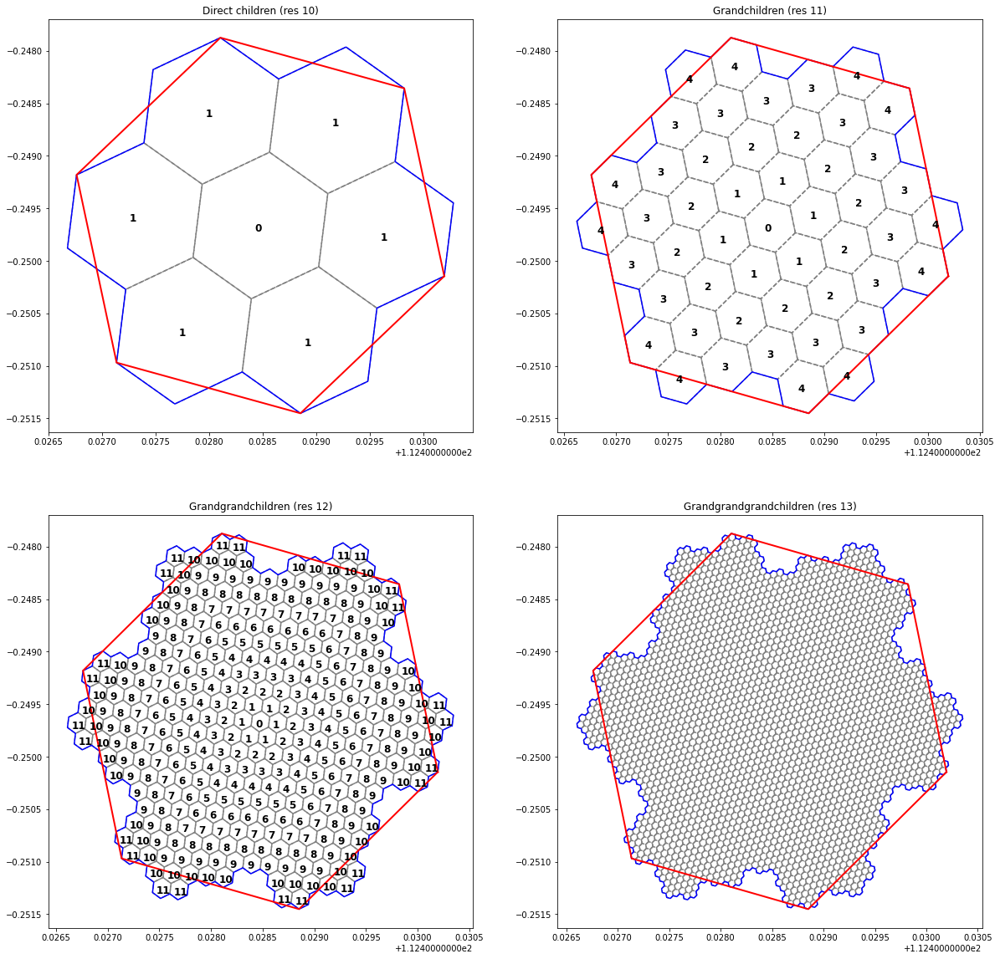

In [29]:
fig, ax = plt.subplots(2, 2, figsize=(20, 20))
list_distances_to_center_dc = plot_parent_and_descendents(
    h3_cell_parent, h3_cells_children, ax=ax[0][0]
)
list_distances_to_center_gc = plot_parent_and_descendents(
    h3_cell_parent, h3_cells_grandchildren, ax=ax[0][1]
)
list_distances_to_center_2xgc = plot_parent_and_descendents(
    h3_cell_parent, h3_cells_2xgrandchildren, ax=ax[1][0]
)
list_distances_to_center_3xgc = plot_parent_and_descendents(
    h3_cell_parent, h3_cells_3xgrandchildren, ax=ax[1][1]
)


ax[0][0].set_title("Direct children (res 10)")
ax[0][1].set_title("Grandchildren (res 11)")
ax[1][0].set_title("Grandgrandchildren (res 12)")
ax[1][1].set_title("Grandgrandgrandchildren (res 13)");
# ax[1][1].axis('off');

## 3. Spatial arrangement of H3 in the ij coordinate system

Info: https://h3geo.org/docs/core-library/coordsystems/

In [30]:
help(h3.experimental_h3_to_local_ij)

Help on function experimental_h3_to_local_ij in module h3.api._api_template:

experimental_h3_to_local_ij(origin, h)
    Return local (i,j) coordinates of cell `h` in relation to `origin` cell
    
    
    Parameters
    ----------
    origin : H3Cell
        Origin/central cell for defining i,j coordinates.
    h: H3Cell
        Destination cell whose i,j coordinates we'd like, based off
        of the origin cell.
    
    
    Returns
    -------
    Tuple (i, j) of integer local coordinates of cell `h`
    
    
    Implementation Notes
    --------------------
    
    The `origin` cell does not define (0, 0) for the IJ coordinate space.
    (0, 0) refers to the center of the base cell containing origin at the
    resolution of `origin`.
    Subtracting the IJ coordinates of `origin` from every cell would get
    you the property of (0, 0) being the `origin`.
    
    This is done so we don't need to keep recomputing the coordinates of
    `origin` if not needed.



In [31]:
def explore_ij_coords(lat_point, lon_point, num_rings=3, ax=None):
    # an example at resolution 9
    hex_id_ex = h3.geo_to_h3(lat=lat_point, lng=lon_point, resolution=9)
    assert h3.h3_get_resolution(hex_id_ex) == 9

    # get its rings
    list_siblings = list(h3.hex_range_distances(h=hex_id_ex, K=num_rings))

    dict_ij = {}
    dict_color = {}
    dict_s = {}

    if ax is None:
        figsize = (min(6 * num_rings, 15), min(6 * num_rings, 15))
        fig, ax = plt.subplots(1, 1, figsize=figsize)

    for ring_level in range(len(list_siblings)):
        if ring_level == 0:
            fontcol = "red"
        elif ring_level == 1:
            fontcol = "blue"
        elif ring_level == 2:
            fontcol = "green"
        else:
            fontcol = "brown"

        if ring_level == 0:
            # on ring 0 is only hex_id_ex
            geom_boundary_coords = h3.h3_to_geo_boundary(hex_id_ex, geo_json=True)
            geom_shp = geometry.Polygon(geom_boundary_coords)
            ax.plot(*geom_shp.exterior.xy, color="purple")

            ij_ex = h3.experimental_h3_to_local_ij(origin=hex_id_ex, h=hex_id_ex)
            s = " {} \n \n (0,0)".format(ij_ex)

            dict_ij[hex_id_ex] = ij_ex
            dict_color[hex_id_ex] = "red"
            dict_s[hex_id_ex] = s

            ax.text(
                x=geom_shp.centroid.x - 0.0017,
                y=geom_shp.centroid.y - 0.0005,
                s=s,
                fontsize=11,
                color=fontcol,
                weight="bold",
            )
        else:
            # get the hex ids resident on ring_level
            siblings_on_ring = list(list_siblings[ring_level])

            k = 1
            for sibling_hex in sorted(siblings_on_ring):
                geom_boundary_coords = h3.h3_to_geo_boundary(sibling_hex, geo_json=True)
                geom_shp = geometry.Polygon(geom_boundary_coords)
                ax.plot(*geom_shp.exterior.xy, color="purple")

                ij = h3.experimental_h3_to_local_ij(origin=hex_id_ex, h=sibling_hex)
                ij_diff = (ij[0] - ij_ex[0], ij[1] - ij_ex[1])
                s = " {} \n \n {}".format(ij, ij_diff)
                k = k + 1

                dict_ij[sibling_hex] = ij
                dict_color[sibling_hex] = fontcol
                dict_s[sibling_hex] = s

                ax.text(
                    x=geom_shp.centroid.x - 0.0017,
                    y=geom_shp.centroid.y - 0.0005,
                    s=s,
                    fontsize=11,
                    color=fontcol,
                    weight="bold",
                )

    ax.set_ylabel("Latitude")
    ax.set_xlabel("Longitude")

    return dict_ij, dict_color, dict_s

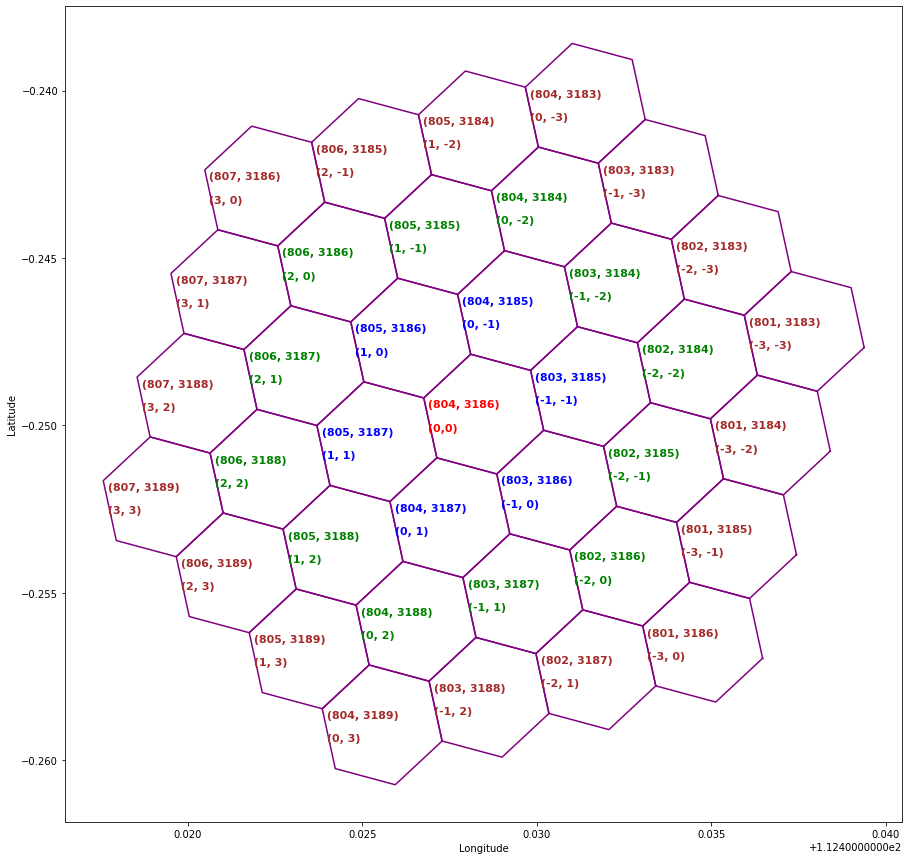

In [32]:
dict_ij, dict_color, dict_s = explore_ij_coords(
    lat_point=lat_centr_point, lon_point=lon_centr_point
)

## 3. Use H3 indexing for spatial operations
### Prepare data

Merging Data Sources: H3 is an excellent choice as a common unit for analysis that merges multiple data sources - you can convert multiple sources into H3 and then e.g. perform cell-based raster arithmetic to get a value for each hexagon. The H3 library itself only offers conversion functions, not data merging functions.

There are different ways to get a raster into the H3 grid. 
- One is by sampling from the raster. We take an H3 grid, and we find a bunch of points we want to sample from the raster. Then we use that to move that raster data into the grid.

- Another way is by taking all the pixels in that raster and finding the associated H3 cell and moving the data in that way.



In [124]:
from processing.geolocating_data import GeolocateAddress

In [125]:
# get geometry for india
indonesia_loc = GeolocateAddress(query="Indonesia")

# generate gdf for india with polygon geometry
gdf_indonesia = gpd.GeoDataFrame.from_features(indonesia_loc.polygon_json, crs="epsg:4326")
gdf_indonesia

Pausing 1 seconds before making HTTP GET request
Get https://nominatim.openstreetmap.org/search?format=json&limit=1&dedupe=0&q=Indonesia with timeout=180
Geocoded "Indonesia" to (117.8902853, -2.4833826)
Params:OrderedDict([('format', 'json'), ('limit', 1), ('dedupe', 0), ('polygon_geojson', 1), ('q', 'Indonesia')])
Preparing url: https://nominatim.openstreetmap.org/search?format=json&limit=1&dedupe=0&polygon_geojson=1&q=Indonesia


,geometry,place_name,bbox_north,bbox_south,bbox_east,bbox_west
0,"POLYGON ((94.77171 5.79699, 94.78901 5.71208, 95.01702 5.19...",Indonesia,6.27445,-11.208567,141.020035,94.771712


In [126]:
##
gdf_indonesia

,geometry,place_name,bbox_north,bbox_south,bbox_east,bbox_west
0,"POLYGON ((94.77171 5.79699, 94.78901 5.71208, 95.01702 5.19...",Indonesia,6.27445,-11.208567,141.020035,94.771712


In [63]:
def base_empty_map():
    """Prepares a folium map centered in a central GPS point of Toulouse"""
    m = Map(
        location=[-0.25, 112.43],
        zoom_start=9.5,
        tiles="cartodbpositron",
        attr="""© <a href="http://www.openstreetmap.org/copyright">
                      OpenStreetMap</a>contributors ©
                      <a href="http://cartodb.com/attributions#basemaps">
                      CartoDB</a>""",
    )
    return m

In [134]:
raw_data = gpd.read_file("../../datasets/processed/located_lg_data_point_v2.shp")
raw_data

,Material,Material d,Volume,Country,Address,Latitude,Longitude,Location t,Accuracy,geometry
0,Rubber,None,710,India,Nakhon Nayok,NaN,NaN,"Origin supplier facility (warehouse, silo, mill, etc.)",Medium,POINT (101.21471 14.20365)
1,Rubber,None,690,Thailand,"Bua Yai, Nakhon Ratchasima",NaN,NaN,"Origin supplier facility (warehouse, silo, mill, etc.)",Medium,POINT (102.42574 15.58717)
2,Rubber,None,660,Thailand,"Roi Et, Roi Et",NaN,NaN,"Origin supplier facility (warehouse, silo, mill, etc.)",Medium,POINT (103.65309 16.05625)
3,Rubber,None,650,India,"Nagercoil, Tamil Nadu",NaN,NaN,"Origin supplier facility (warehouse, silo, mill, etc.)",Medium,POINT (77.42905 8.18805)
4,Rubber,None,650,Thailand,"Phichit, Phichit",NaN,NaN,"Origin supplier facility (warehouse, silo, mill, etc.)",Medium,POINT (100.34303 16.44211)
5,Rubber,None,147,Indonesia,None,-3.10,120.24,"Point of production (farm, ranch, plantation, etc.)",High,POINT (120.24000 -3.10000)
6,Rubber,None,289,Laos,None,20.28,100.41,"Point of production (farm, ranch, plantation, etc.)",High,POINT (100.41000 20.28000)
7,Rubber,None,362,Thailand,None,8.45,98.53,"Point of production (farm, ranch, plantation, etc.)",High,POINT (98.53000 8.45000)
8,Rubber,None,502,Thailand,None,17.01,99.75,"Point of production (farm, ranch, plantation, etc.)",High,POINT (99.75000 17.01000)
9,Rubber,None,356,Liberia,None,5.01,-9.04,"Point of production (farm, ranch, plantation, etc.)",High,POINT (-9.04000 5.01000)


In [141]:
## add the
long_list = [raw_data.iloc[i]["geometry"].x for i in range(0, len(raw_data))]
lat_list = [raw_data.iloc[i]["geometry"].y for i in range(0, len(raw_data))]
raw_data["Latitude"] = lat_list
raw_data["Longitude"] = long_list

In [143]:
# quick visualization on map of raw data

m = base_empty_map()
mc = MarkerCluster()

for i, row in raw_data.iterrows():
    mk = Marker(location=[row["Latitude"], row["Longitude"]])
    mk.add_to(mc)

mc.add_to(m)
m

### Create a new dataframe to work with throughout the notebook:

In [145]:
gdf_raw_cpy = raw_data.reset_index(inplace=False, drop=False)
df = gdf_raw_cpy.groupby(by=["Longitude", "Latitude"]).agg(
    {"Material": "first", "Volume": sum, "Country": "first"}
)
df.reset_index(inplace=True, drop=False)
df.head()

,Longitude,Latitude,Material,Volume,Country
0,-112.720000,32.95000,Cotton,398,USA
1,-77.940000,-2.85000,Leather,169,Ecuador
2,-76.480000,-6.51000,Cotton,124,Peru
3,-68.741703,10.33948,Leather,410,Venezuela
4,-61.170000,-26.52000,Cotton,135,Argentina


### Index data spatially with H3

In [149]:
for res in range(7, 11):
    col_hex_id = "hex_id_{}".format(res)
    col_geom = "geometry_{}".format(res)
    msg_ = "At resolution {} -->  H3 cell id : {} and its geometry: {} "
    print(msg_.format(res, col_hex_id, col_geom))
    df[col_hex_id] = df.apply(
        lambda row: h3.geo_to_h3(lat=row["Latitude"], lng=row["Longitude"], resolution=res), axis=1
    )
    # use h3.h3_to_geo_boundary to obtain the geometries of these hexagons
    df[col_geom] = df[col_hex_id].apply(
        lambda x: {"type": "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=x, geo_json=True)]}
    )
    df.head().T

At resolution 7 -->  H3 cell id : hex_id_7 and its geometry: geometry_7 
At resolution 8 -->  H3 cell id : hex_id_8 and its geometry: geometry_8 
At resolution 9 -->  H3 cell id : hex_id_9 and its geometry: geometry_9 
At resolution 10 -->  H3 cell id : hex_id_10 and its geometry: geometry_10 


In [152]:
df.head().T

,0,1,2,3,4
Longitude,-112.72,-77.94,-76.48,-68.741703,-61.17
Latitude,32.95,-2.85,-6.51,10.33948,-26.52
Material,Cotton,Leather,Cotton,Leather,Cotton
Volume,398,169,124,410,135
Country,USA,Ecuador,Peru,Venezuela,Argentina
hex_id_7,8748e906bffffff,878f74004ffffff,878f4056cffffff,87675cbacffffff,87a969a9dffffff
geometry_7,"{'type': 'Polygon', 'coordinates': [((-112.7030475111078, 3...","{'type': 'Polygon', 'coordinates': [((-77.9445580100373, -2...","{'type': 'Polygon', 'coordinates': [((-76.49239219672506, -...","{'type': 'Polygon', 'coordinates': [((-68.74255090341751, 1...","{'type': 'Polygon', 'coordinates': [((-61.174570103301555, ..."
hex_id_8,8848e906b3fffff,888f740041fffff,888f4056c3fffff,88675cbacdfffff,88a969a9d1fffff
geometry_8,"{'type': 'Polygon', 'coordinates': [((-112.71663047966699, ...","{'type': 'Polygon', 'coordinates': [((-77.93937745909274, -...","{'type': 'Polygon', 'coordinates': [((-76.48191069212798, -...","{'type': 'Polygon', 'coordinates': [((-68.74255090341751, 1...","{'type': 'Polygon', 'coordinates': [((-61.16936057005532, -..."
hex_id_9,8948e906b37ffff,898f740041bffff,898f4056c27ffff,89675cbacd3ffff,89a969a9d13ffff


## Compute Point in Polygon (spatial join) usig the H3 index


In [196]:
!ls ../../datasets/raw/

 gadm36_IDN_1.cpg   gadm36_IDN_2.shx   gadm36_IDN_4.shp
 gadm36_IDN_1.dbf   gadm36_IDN_3.cpg   gadm36_IDN_4.shx
 gadm36_IDN_1.prj   gadm36_IDN_3.dbf   ind_geo.json
 gadm36_IDN_1.shp   gadm36_IDN_3.prj  'LG fake data sheet - Raw materials.csv'
 gadm36_IDN_1.shx   gadm36_IDN_3.shp   license.txt
 gadm36_IDN_2.cpg   gadm36_IDN_3.shx  'map (1).geojson'
 gadm36_IDN_2.dbf   gadm36_IDN_4.cpg  'Screenshot from 2021-05-13 15-37-12.png'
 gadm36_IDN_2.prj   gadm36_IDN_4.dbf
 gadm36_IDN_2.shp   gadm36_IDN_4.prj


In [26]:
ind_gdf = gpd.read_file("../../datasets/raw/ind_geo.json")
ind_gdf.head()

,GID_0,NAME_0,GID_1,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,geometry
0,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"MULTIPOLYGON (((96.66509 2.12018, 96.66765 2.1..."
1,IDN,Indonesia,IDN.2_1,Bali,None,None,Propinisi,Province,51,ID.BA,"MULTIPOLYGON (((115.59464 -8.81672, 115.59444 ..."
2,IDN,Indonesia,IDN.3_1,Bangka Belitung,None,None,Propinisi,Province,19,ID.BB,"MULTIPOLYGON (((107.96173 -3.41100, 107.96220 ..."
3,IDN,Indonesia,IDN.4_1,Banten,None,None,Propinisi,Province,36,ID.BT,"MULTIPOLYGON (((105.54977 -6.99566, 105.55035 ..."
4,IDN,Indonesia,IDN.5_1,Bengkulu,None,None,Propinisi,Province,17,ID.BE,"MULTIPOLYGON (((102.37586 -5.36968, 102.38067 ..."


In [29]:
ind_gdf_test = ind_gdf[:1]
ind_gdf_test

,GID_0,NAME_0,GID_1,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,geometry
0,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"MULTIPOLYGON (((96.66509 2.12018, 96.66765 2.1..."


In [33]:
## multipolygon to polygon
import geopandas as gpd
from shapely.geometry.multipolygon import MultiPolygon
from shapely.geometry.polygon import Polygon


def explode(indf):
    # indf = gpd.GeoDataFrame.from_file(indata)
    outdf = gpd.GeoDataFrame(columns=indf.columns)
    for idx, row in indf.iterrows():
        if type(row.geometry) == Polygon:
            outdf = outdf.append(row, ignore_index=True)
        if type(row.geometry) == MultiPolygon:
            multdf = gpd.GeoDataFrame(columns=indf.columns)
            recs = len(row.geometry)
            multdf = multdf.append([row] * recs, ignore_index=True)
            for geom in range(recs):
                multdf.loc[geom, "geometry"] = row.geometry[geom]
            outdf = outdf.append(multdf, ignore_index=True)
    return outdf

In [35]:
ind_gdf_test = explode(ind_gdf_test)
ind_gdf_test.head()

,GID_0,NAME_0,GID_1,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,geometry
0,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"POLYGON ((96.66509 2.12018, 96.66765 2.11815, ..."
1,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"POLYGON ((97.12111 2.11732, 97.12733 2.11504, ..."
2,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"POLYGON ((98.14902 2.13469, 98.14809 2.13457, ..."
3,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"POLYGON ((97.35938 2.13017, 97.35866 2.12944, ..."
4,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"POLYGON ((97.39711 2.03835, 97.39588 2.03794, ..."


In [39]:
# save polygon file as geojson
ind_gdf_test.to_file("../../datasets/raw/ind_geo_test.json", driver="GeoJSON")

In [7]:
def load_and_prepare_districts(filepath):
    """Loads a geojson files of polygon geometries and features,
    swaps the latitude and longitude andstores geojson"""
    gdf = gpd.read_file(filepath, driver="GeoJSON")

    gdf["geom_geojson"] = gdf["geometry"].apply(lambda x: geometry.mapping(x))

    gdf["geom_swap"] = gdf["geometry"].map(
        lambda polygon: ops.transform(lambda x, y: (y, x), polygon)
    )

    gdf["geom_swap_geojson"] = gdf["geom_swap"].apply(lambda x: geometry.mapping(x))

    return gdf

In [40]:
ind_gdf_swap = load_and_prepare_districts(filepath="../../datasets/raw/ind_geo_test.json")
ind_gdf_swap.head()

,GID_0,NAME_0,GID_1,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,geometry,geom_geojson,geom_swap,geom_swap_geojson
0,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"POLYGON ((96.66509 2.12018, 96.66765 2.11815, ...","{'type': 'Polygon', 'coordinates': (((96.66509...","POLYGON ((2.120 96.665, 2.118 96.668, 2.116 96...","{'type': 'Polygon', 'coordinates': (((2.120178..."
1,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"POLYGON ((97.12111 2.11732, 97.12733 2.11504, ...","{'type': 'Polygon', 'coordinates': (((97.12110...","POLYGON ((2.117 97.121, 2.115 97.127, 2.112 97...","{'type': 'Polygon', 'coordinates': (((2.117320..."
2,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"POLYGON ((98.14902 2.13469, 98.14809 2.13457, ...","{'type': 'Polygon', 'coordinates': (((98.14902...","POLYGON ((2.135 98.149, 2.135 98.148, 2.135 98...","{'type': 'Polygon', 'coordinates': (((2.134688..."
3,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"POLYGON ((97.35938 2.13017, 97.35866 2.12944, ...","{'type': 'Polygon', 'coordinates': (((97.35938...","POLYGON ((2.130 97.359, 2.129 97.359, 2.129 97...","{'type': 'Polygon', 'coordinates': (((2.130167..."
4,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"POLYGON ((97.39711 2.03835, 97.39588 2.03794, ...","{'type': 'Polygon', 'coordinates': (((97.39710...","POLYGON ((2.038 97.397, 2.038 97.396, 2.038 97...","{'type': 'Polygon', 'coordinates': (((2.038349..."


In [41]:
print(ind_gdf_swap.shape)

(148, 14)


### Initial fill:

In [42]:
help(h3.polyfill)

Help on function polyfill in module h3.api._api_template:

polyfill(geojson, res, geo_json_conformant=False)
    Get set of hexagons whose *centers* are contained within
    a GeoJSON-style polygon.
    
    Parameters
    ----------
    geojson : dict
        GeoJSON-style input dictionary describing a polygon (optionally
        including holes).
    
        Dictionary should be formatted like:
    
        ```
        {
            'type': 'Polygon',
            'coordinates': [outer, hole1, hole2, ...],
        }
        ```
        `outer`, `hole1`, etc., are lists of geo coordinate tuples.
        The holes are optional.
    
    res : int
        Desired output resolution for cells.
    geo_json_conformant : bool, optional
        When `True`, `outer`, `hole1`, etc. must be sequences of
        lng/lat pairs, with the last the same as the first.
        When `False`, they must be sequences of lat/lng pairs,
        with the last not needing to match the first.
    
    Returns


In [43]:
def fill_hexagons(geom_geojson, res, flag_swap=False, flag_return_df=False):
    """Fills a geometry given in geojson format with H3 hexagons at specified
    resolution. The flag_reverse_geojson allows to specify whether the geometry
    is lon/lat or swapped"""

    set_hexagons = h3.polyfill(geojson=geom_geojson, res=res, geo_json_conformant=flag_swap)
    list_hexagons_filling = list(set_hexagons)

    if flag_return_df is True:
        # make dataframe
        df_fill_hex = pd.DataFrame({"hex_id": list_hexagons_filling})
        df_fill_hex["value"] = 0
        df_fill_hex["geometry"] = df_fill_hex.hex_id.apply(
            lambda x: {
                "type": "Polygon",
                "coordinates": [h3.h3_to_geo_boundary(h=x, geo_json=True)],
            }
        )
        assert df_fill_hex.shape[0] == len(list_hexagons_filling)
        return df_fill_hex
    else:
        return list_hexagons_filling

In [44]:
ind_gdf_swap.head()

,GID_0,NAME_0,GID_1,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,geometry,geom_geojson,geom_swap,geom_swap_geojson
0,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"POLYGON ((96.66509 2.12018, 96.66765 2.11815, ...","{'type': 'Polygon', 'coordinates': (((96.66509...","POLYGON ((2.120 96.665, 2.118 96.668, 2.116 96...","{'type': 'Polygon', 'coordinates': (((2.120178..."
1,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"POLYGON ((97.12111 2.11732, 97.12733 2.11504, ...","{'type': 'Polygon', 'coordinates': (((97.12110...","POLYGON ((2.117 97.121, 2.115 97.127, 2.112 97...","{'type': 'Polygon', 'coordinates': (((2.117320..."
2,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"POLYGON ((98.14902 2.13469, 98.14809 2.13457, ...","{'type': 'Polygon', 'coordinates': (((98.14902...","POLYGON ((2.135 98.149, 2.135 98.148, 2.135 98...","{'type': 'Polygon', 'coordinates': (((2.134688..."
3,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"POLYGON ((97.35938 2.13017, 97.35866 2.12944, ...","{'type': 'Polygon', 'coordinates': (((97.35938...","POLYGON ((2.130 97.359, 2.129 97.359, 2.129 97...","{'type': 'Polygon', 'coordinates': (((2.130167..."
4,IDN,Indonesia,IDN.1_1,Aceh,None,None,Propinisi,Province,11,ID.AC,"POLYGON ((97.39711 2.03835, 97.39588 2.03794, ...","{'type': 'Polygon', 'coordinates': (((97.39710...","POLYGON ((2.038 97.397, 2.038 97.396, 2.038 97...","{'type': 'Polygon', 'coordinates': (((2.038349..."


In [45]:
ind_gdf_swap["hex_fill_initial"] = ind_gdf_swap["geom_swap_geojson"].apply(
    lambda x: list(fill_hexagons(geom_geojson=x, res=13))
)
ind_gdf_swap["num_hex_fill_initial"] = ind_gdf_swap["hex_fill_initial"].apply(len)

total_num_hex_initial = ind_gdf_swap["num_hex_fill_initial"].sum()
print("Until here, we'd have to search over {} hexagons".format(total_num_hex_initial))

ind_gdf_swap[["geometry", "num_hex_fill_initial"]].head()

Until here, we'd have to search over 46094919 hexagons


,geometry,num_hex_fill_initial
0,"POLYGON ((96.66509 2.12018, 96.66765 2.11815, ...",889540
1,"POLYGON ((97.12111 2.11732, 97.12733 2.11504, ...",1181409
2,"POLYGON ((98.14902 2.13469, 98.14809 2.13457, ...",605
3,"POLYGON ((97.35938 2.13017, 97.35866 2.12944, ...",5290
4,"POLYGON ((97.39711 2.03835, 97.39588 2.03794, ...",11844


### Compacted fill

In [46]:
## we may want to compact the df output
help(h3.compact)

Help on function compact in module h3.api._api_template:

compact(hexes)
    Compact a collection of H3 cells by combining
    smaller cells into larger cells, if all child cells
    are present.
    
    Parameters
    ----------
    hexes : iterable of H3Cell
    
    Returns
    -------
    unordered collection of H3Cell



In [50]:
test_gdf = ind_gdf_swap[:15]

In [52]:
test_gdf["hex_fill_compact"] = test_gdf["hex_fill_initial"].apply(lambda x: list(h3.compact(x)))
test_gdf["num_hex_fill_compact"] = test_gdf["hex_fill_compact"].apply(len)

print(
    "Reduced number of cells from {} to {} \n".format(
        test_gdf["num_hex_fill_initial"].sum(), test_gdf["num_hex_fill_compact"].sum()
    )
)

# count cells by index resolution after compacting

test_gdf["hex_resolutions"] = test_gdf["hex_fill_compact"].apply(
    lambda x: [h3.h3_get_resolution(hexid) for hexid in x]
)
test_gdf["hex_resolutions_counts"] = test_gdf["hex_resolutions"].apply(lambda x: Counter(x))
test_gdf[
    ["geometry", "num_hex_fill_initial", "num_hex_fill_compact", "hex_resolutions_counts"]
].head()

Reduced number of cells from 6614373 to 47571 



,geometry,num_hex_fill_initial,num_hex_fill_compact,hex_resolutions_counts
0,"POLYGON ((96.66509 2.12018, 96.66765 2.11815, ...",889540,5914,"{10: 217, 12: 1374, 13: 3753, 11: 486, 8: 16, ..."
1,"POLYGON ((97.12111 2.11732, 97.12733 2.11504, ...",1181409,8139,"{13: 5052, 12: 1899, 11: 762, 9: 112, 10: 293,..."
2,"POLYGON ((98.14902 2.13469, 98.14809 2.13457, ...",605,125,"{12: 40, 13: 80, 11: 5}"
3,"POLYGON ((97.35938 2.13017, 97.35866 2.12944, ...",5290,436,"{12: 98, 13: 292, 11: 39, 10: 7}"
4,"POLYGON ((97.39711 2.03835, 97.39588 2.03794, ...",11844,636,"{12: 164, 13: 406, 11: 49, 10: 16, 9: 1}"


In [53]:
# this column of empty lists is a placeholder, will be used further in this section
test_gdf["compacted_novoids"] = [[] for _ in range(test_gdf.shape[0])]

In [60]:
def plot_basemap_region_fill(df_boundaries_zones, initial_map=None):
    """On a folium map, add the boundaries of the geometries in geojson formatted
    column of df_boundaries_zones"""

    if initial_map is None:
        initial_map = base_empty_map()

    feature_group = folium.FeatureGroup(name="Boundaries")

    for i, row in df_boundaries_zones.iterrows():
        feature_sel = Feature(geometry=row["geom_geojson"], id=str(i))
        feat_collection_sel = FeatureCollection([feature_sel])
        geojson_subzone = json.dumps(feat_collection_sel)

        GeoJson(
            geojson_subzone,
            style_function=lambda feature: {
                "fillColor": None,
                "color": "blue",
                "weight": 5,
                "fillOpacity": 0,
            },
        ).add_to(feature_group)

    feature_group.add_to(initial_map)
    return initial_map


# ---------------------------------------------------------------------------


def hexagons_dataframe_to_geojson(
    df_hex, hex_id_field, geometry_field, value_field, file_output=None
):
    """Produce the GeoJSON representation containing all geometries in a dataframe
    based on a column in geojson format (geometry_field)"""

    list_features = []

    for i, row in df_hex.iterrows():
        feature = Feature(
            geometry=row[geometry_field],
            id=row[hex_id_field],
            properties={"value": row[value_field]},
        )
        list_features.append(feature)

    feat_collection = FeatureCollection(list_features)

    geojson_result = json.dumps(feat_collection)

    # optionally write to file
    if file_output is not None:
        with open(file_output, "w") as f:
            json.dump(feat_collection, f)

    return geojson_result


# ---------------------------------------------------------------------------------


def map_addlayer_filling(df_fill_hex, layer_name, map_initial, fillcolor=None):
    """On a folium map (likely created with plot_basemap_region_fill),
    add a layer of hexagons that filled the geometry at given H3 resolution
    (df_fill_hex returned by fill_hexagons method)"""

    geojson_hx = hexagons_dataframe_to_geojson(
        df_fill_hex, hex_id_field="hex_id", value_field="value", geometry_field="geometry"
    )

    GeoJson(
        geojson_hx,
        style_function=lambda feature: {
            "fillColor": fillcolor,
            "color": "red",
            "weight": 2,
            "fillOpacity": 0.1,
        },
        name=layer_name,
    ).add_to(map_initial)

    return map_initial

In [65]:
def visualize_filled_compact(gdf, fillcolor=None):
    overall_map = base_empty_map()
    map_ = plot_basemap_region_fill(gdf, initial_map=overall_map)

    for i, row in gdf.iterrows():
        if len(row["compacted_novoids"]) > 0:
            list_hexagons_filling_compact = row["compacted_novoids"]
        else:
            list_hexagons_filling_compact = []

        list_hexagons_filling_compact.extend(row["hex_fill_compact"])
        list_hexagons_filling_compact = list(set(list_hexagons_filling_compact))

        # make dataframes
        df_fill_compact = pd.DataFrame({"hex_id": list_hexagons_filling_compact})
        df_fill_compact["value"] = 0
        df_fill_compact["geometry"] = df_fill_compact.hex_id.apply(
            lambda x: {
                "type": "Polygon",
                "coordinates": [h3.h3_to_geo_boundary(h=x, geo_json=True)],
            }
        )

        map_fill_compact = map_addlayer_filling(
            df_fill_hex=df_fill_compact,
            layer_name="test_ind",
            map_initial=map_,
            fillcolor=fillcolor,
        )
    folium.map.LayerControl("bottomright", collapsed=True).add_to(map_fill_compact)

    return map_fill_compact

In [66]:
visualize_filled_compact(gdf=test_gdf)

Exception ignored in: <function Collection.__del__ at 0x7fc488546820>
Traceback (most recent call last):
  File "/opt/conda/lib/python3.8/site-packages/fiona/collection.py", line 484, in __del__
    self.close()
  File "/opt/conda/lib/python3.8/site-packages/fiona/collection.py", line 454, in close
    if self.session is not None and self.session.isactive():
AttributeError: 'Collection' object has no attribute 'session'


If we check the detaile of the filled polygons, we can see some voinds (even though we have compacted some hexagons). THese small voids occur at the juxtaposition of hexagins cells of differet H3 resolutions (as we have seen above the parent's polygon doesn't overlap completely with the multipolygon of its children union. 

A consequence of this, for our spatial join, is that any point that would fall exactly in a void would be wrongly labelled as outside of the impact area. 

This voids can be filled 

In [69]:
def generate_filled_compact(gdf):
    for i, row in gdf.iterrows():
        if len(row["compacted_novoids"]) > 0:
            list_hexagons_filling_compact = row["compacted_novoids"]
        else:
            list_hexagons_filling_compact = []

        list_hexagons_filling_compact.extend(row["hex_fill_compact"])
        list_hexagons_filling_compact = list(set(list_hexagons_filling_compact))

        # make dataframes
        df_fill_compact = pd.DataFrame({"hex_id": list_hexagons_filling_compact})
        df_fill_compact["value"] = 0
        df_fill_compact["geometry"] = df_fill_compact.hex_id.apply(
            lambda x: {
                "type": "Polygon",
                "coordinates": [h3.h3_to_geo_boundary(h=x, geo_json=True)],
            }
        )

    return df_fill_compact

In [70]:
to_save_gdf = generate_filled_compact(test_gdf)
to_save_gdf.head()

,hex_id,value,geometry
0,8d657041cd3453f,0,"{'type': 'Polygon', 'coordinates': [((97.34579..."
1,8d657040604027f,0,"{'type': 'Polygon', 'coordinates': [((97.36261..."
2,886570405bfffff,0,"{'type': 'Polygon', 'coordinates': [((97.33584..."
3,8d657041e29503f,0,"{'type': 'Polygon', 'coordinates': [((97.33144..."
4,8c6570423b225ff,0,"{'type': 'Polygon', 'coordinates': [((97.35160..."


In [72]:
to_save_gdf.to_json("test_hex_export.json")

In [73]:
len(to_save_gdf)

26273

In [81]:
import json

from shapely.geometry import shape

to_save_gdf["the_geom"] = to_save_gdf["geometry"].apply(lambda x: shape(x))

In [82]:
to_save_gdf.head()

,hex_id,value,geometry,the_geom
0,8d657041cd3453f,0,"{'type': 'Polygon', 'coordinates': [((97.34579...","POLYGON ((97.34579036479532 2.133977082610669,..."
1,8d657040604027f,0,"{'type': 'Polygon', 'coordinates': [((97.36261...","POLYGON ((97.36261795806105 2.102919400270516,..."
2,886570405bfffff,0,"{'type': 'Polygon', 'coordinates': [((97.33584...","POLYGON ((97.33584928281961 2.064628841695215,..."
3,8d657041e29503f,0,"{'type': 'Polygon', 'coordinates': [((97.33144...","POLYGON ((97.33144690166498 2.164762087659729,..."
4,8c6570423b225ff,0,"{'type': 'Polygon', 'coordinates': [((97.35160...","POLYGON ((97.35160780040333 2.047749376070763,..."


In [83]:
to_save_gdf.set_geometry("the_geom")

,hex_id,value,geometry,the_geom
0,8d657041cd3453f,0,"{'type': 'Polygon', 'coordinates': [((97.34579...","POLYGON ((97.34579 2.13398, 97.34578 2.13402, ..."
1,8d657040604027f,0,"{'type': 'Polygon', 'coordinates': [((97.36261...","POLYGON ((97.36262 2.10292, 97.36261 2.10296, ..."
2,886570405bfffff,0,"{'type': 'Polygon', 'coordinates': [((97.33584...","POLYGON ((97.33585 2.06463, 97.33626 2.06978, ..."
3,8d657041e29503f,0,"{'type': 'Polygon', 'coordinates': [((97.33144...","POLYGON ((97.33145 2.16476, 97.33144 2.16480, ..."
4,8c6570423b225ff,0,"{'type': 'Polygon', 'coordinates': [((97.35160...","POLYGON ((97.35161 2.04775, 97.35162 2.04785, ..."
...,...,...,...,...
26268,8d6570794d06dbf,0,"{'type': 'Polygon', 'coordinates': [((97.12831...","POLYGON ((97.12831 2.20509, 97.12830 2.20513, ..."
26269,8d657042e6282bf,0,"{'type': 'Polygon', 'coordinates': [((97.32557...","POLYGON ((97.32558 2.05917, 97.32557 2.05921, ..."
26270,8c65704f3c023ff,0,"{'type': 'Polygon', 'coordinates': [((97.28078...","POLYGON ((97.28079 2.22723, 97.28079 2.22733, ..."
26271,8d657041a17673f,0,"{'type': 'Polygon', 'coordinates': [((97.32298...","POLYGON ((97.32298 2.17392, 97.32297 2.17396, ..."


In [84]:
gdf_ = gpd.GeoDataFrame(to_save_gdf)
gdf_.head()

,hex_id,value,geometry,the_geom
0,8d657041cd3453f,0,"{'type': 'Polygon', 'coordinates': [((97.34579...","POLYGON ((97.34579036479532 2.133977082610669,..."
1,8d657040604027f,0,"{'type': 'Polygon', 'coordinates': [((97.36261...","POLYGON ((97.36261795806105 2.102919400270516,..."
2,886570405bfffff,0,"{'type': 'Polygon', 'coordinates': [((97.33584...","POLYGON ((97.33584928281961 2.064628841695215,..."
3,8d657041e29503f,0,"{'type': 'Polygon', 'coordinates': [((97.33144...","POLYGON ((97.33144690166498 2.164762087659729,..."
4,8c6570423b225ff,0,"{'type': 'Polygon', 'coordinates': [((97.35160...","POLYGON ((97.35160780040333 2.047749376070763,..."


In [91]:
test_2 = gpd.GeoDataFrame(gdf_[["hex_id", "the_geom"]])
test_2.head()

,hex_id,the_geom
0,8d657041cd3453f,"POLYGON ((97.34579036479532 2.133977082610669,..."
1,8d657040604027f,"POLYGON ((97.36261795806105 2.102919400270516,..."
2,886570405bfffff,"POLYGON ((97.33584928281961 2.064628841695215,..."
3,8d657041e29503f,"POLYGON ((97.33144690166498 2.164762087659729,..."
4,8c6570423b225ff,"POLYGON ((97.35160780040333 2.047749376070763,..."


In [93]:
test_2.set_geometry("the_geom")

,hex_id,the_geom
0,8d657041cd3453f,"POLYGON ((97.34579 2.13398, 97.34578 2.13402, ..."
1,8d657040604027f,"POLYGON ((97.36262 2.10292, 97.36261 2.10296, ..."
2,886570405bfffff,"POLYGON ((97.33585 2.06463, 97.33626 2.06978, ..."
3,8d657041e29503f,"POLYGON ((97.33145 2.16476, 97.33144 2.16480, ..."
4,8c6570423b225ff,"POLYGON ((97.35161 2.04775, 97.35162 2.04785, ..."
...,...,...
26268,8d6570794d06dbf,"POLYGON ((97.12831 2.20509, 97.12830 2.20513, ..."
26269,8d657042e6282bf,"POLYGON ((97.32558 2.05917, 97.32557 2.05921, ..."
26270,8c65704f3c023ff,"POLYGON ((97.28079 2.22723, 97.28079 2.22733, ..."
26271,8d657041a17673f,"POLYGON ((97.32298 2.17392, 97.32297 2.17396, ..."


In [95]:
test_2["geometry"] = test_2["the_geom"]

<AxesSubplot:>

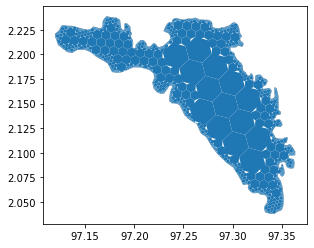

In [100]:
test_2[["hex_id", "geometry"]].plot()

## Populating hexagons with maps data - Polyfill

In [103]:
!ls ../../datasets/raw

 cvalenciana.cpg    gadm36_IDN_2.dbf   gadm36_IDN_4.prj
 cvalenciana.dbf    gadm36_IDN_2.prj   gadm36_IDN_4.shp
 cvalenciana.prj    gadm36_IDN_2.shp   gadm36_IDN_4.shx
 cvalenciana.shp    gadm36_IDN_2.shx   ind_geo.json
 cvalenciana.shx    gadm36_IDN_3.cpg   ind_geo_test.json
 gadm36_IDN_1.cpg   gadm36_IDN_3.dbf  'LG fake data sheet - Raw materials.csv'
 gadm36_IDN_1.dbf   gadm36_IDN_3.prj   license.txt
 gadm36_IDN_1.prj   gadm36_IDN_3.shp  'map (1).geojson'
 gadm36_IDN_1.shp   gadm36_IDN_3.shx  'Screenshot from 2021-05-13 15-37-12.png'
 gadm36_IDN_1.shx   gadm36_IDN_4.cpg
 gadm36_IDN_2.cpg   gadm36_IDN_4.dbf


In [66]:
cv = gpd.read_file("../../datasets/raw/cvalenciana.shp")
cv.head()

,GID_0,NAME_0,GID_1,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,geometry
0,ESP,Spain,ESP.10_1,Comunidad Valenciana,Valencia|Communauté de Valence|Comunidade Vale...,None,Comunidad Autónoma,Autonomous Community,10,ES.VC,"MULTIPOLYGON (((-0.45708 38.16208, -0.45708 38..."


In [47]:
cv_test = gpd.read_file("../../datasets/raw/cvalenciana_test.shp")
cv_test.head()

,GID_0,NAME_0,GID_1,NAME_1,NL_NAME_1,GID_2,NAME_2,NL_NAME_2,GID_3,NAME_3,VARNAME_3,NL_NAME_3,TYPE_3,ENGTYPE_3,CC_3,HASC_3,geometry
0,ESP,Spain,ESP.10_1,Comunidad Valenciana,None,ESP.10.3_1,Valencia,None,ESP.10.3.10_1,Horta Sud,None,None,Comarca,Comarca,None,None,"POLYGON ((-0.42611 39.33041, -0.42158 39.30974..."


In [8]:
# Create an empty dataframe to write data into
h3_df = pd.DataFrame([], columns=["country", "city", "h3_id", "h3_geo_boundary", "h3_centroid"])

In [54]:
import shapely

In [74]:
district_polygon = list(cv.iloc[0]["geometry"])

In [73]:
polygon_geojson = gpd.GeoSeries(cv.iloc[0]["geometry"]).__geo_interface__

In [75]:
polygon_geojson = gpd.GeoSeries(district_geom[11]).__geo_interface__

In [76]:
poly_geojson = polygon_geojson["features"][0]["geometry"]

In [77]:
h3_hexes = h3.polyfill_geojson(poly_geojson, 8)

In [78]:
h3_hexes

{'883950d8abfffff',
 '88395416e3fffff',
 '883909ae05fffff',
 '88397340ddfffff',
 '88395469a3fffff',
 '8839563aa7fffff',
 '8839549515fffff',
 '8839730737fffff',
 '883956ad6dfffff',
 '883956a325fffff',
 '88397358c3fffff',
 '8839730281fffff',
 '88395619a9fffff',
 '8839549545fffff',
 '883954d8e7fffff',
 '883956b49dfffff',
 '8839093683fffff',
 '8839563547fffff',
 '8839568345fffff',
 '8839730625fffff',
 '8839730287fffff',
 '883954d665fffff',
 '8839541331fffff',
 '8839731addfffff',
 '883973cc1bfffff',
 '8839545a29fffff',
 '8839540a27fffff',
 '88395449a5fffff',
 '8839548e83fffff',
 '8839547009fffff',
 '8839544599fffff',
 '883954185dfffff',
 '8839560aa1fffff',
 '883956a6edfffff',
 '883973581bfffff',
 '8839547abdfffff',
 '883956362dfffff',
 '88395442e7fffff',
 '8839731893fffff',
 '8839541981fffff',
 '8839540353fffff',
 '883950c1a7fffff',
 '88397319b1fffff',
 '8839733867fffff',
 '883954136dfffff',
 '883954b2edfffff',
 '883954db43fffff',
 '8839561133fffff',
 '883909ad61fffff',
 '88395646a3fffff',


In [79]:
# Create an empty dataframe to write data into
h3_df = pd.DataFrame([], columns=["h3_id", "h3_geo_boundary", "h3_centroid"])
for h3_hex in h3_hexes:
    h3_geo_boundary = shapely.geometry.Polygon(h3.h3_to_geo_boundary(h3_hex, geo_json=True))

    h3_centroid = h3.h3_to_geo(h3_hex)
    # Append results to dataframe
    h3_df.loc[len(h3_df)] = [h3_hex, h3_geo_boundary, h3_centroid]

In [80]:
h3_df.to_csv("../../datasets/processed/hex3_test_v4_8res.csv", index=False)

In [44]:
test_h3 = list(h3_hexes)[:50]

In [45]:
# Create an empty dataframe to write data into
h3_df_test = pd.DataFrame([], columns=["h3_id", "h3_geo_boundary", "h3_centroid"])
for h3_hex in test_h3:
    h3_geo_boundary = shapely.geometry.Polygon(h3.h3_to_geo_boundary(h3_hex, geo_json=True))

    h3_centroid = h3.h3_to_geo(h3_hex)
    # Append results to dataframe
    h3_df_test.loc[len(h3_df)] = [h3_hex, h3_geo_boundary, h3_centroid]

In [46]:
h3_df_test.to_csv("../../datasets/processed/hex3_test_v2.csv", index=False)

In [10]:
# Iterate over every row of the geo dataframe
for i, row in cv.iterrows():
    # Parse out info from columns of row
    country = row.NAME_0
    city = row.NAME_1
    district_multipolygon = row.geometry
    # Convert multi-polygon into list of polygons
    district_polygon = list(district_multipolygon)
    for polygon in district_polygon:
        # Convert Polygon to GeoJSON dictionary
        poly_geojson = gpd.GeoSeries([polygon]).__geo_interface__
        # Parse out geometry key from GeoJSON dictionary
        poly_geojson = poly_geojson["features"][0]["geometry"]
        # Fill the dictionary with Resolution 10 H3 Hexagons
        h3_hexes = h3.polyfill_geojson(poly_geojson, 10)
        for h3_hex in h3_hexes:
            h3_geo_boundary = shapely.geometry.Polygon(h3.h3_to_geo_boundary(h3_hex, geo_json=True))
            h3_centroid = h3.h3_to_geo(h3_hex)
            # Append results to dataframe
            h3_df.loc[len(h3_df)] = [country, city, h3_hex, h3_geo_boundary, h3_centroid]